# Experiment: photonic backpropagation demonstration and errors

In this notebook, we cover the steps required to replicate the backpropagation experiment.

This backpropagation measurement is specifically for a three-layer unitary neural network used in 2D classification tasks. However, our approach can be extended to much larger neural networks.

## Imports

In [1]:
%load_ext autoreload
%autoreload 2

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
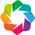

In [2]:
# general use imports

import matplotlib.pyplot as plt
import matplotlib
plt.rcParams.update({"text.usetex": True})
plt.rcParams['text.latex.preamble'] = r"\usepackage{bm} \usepackage{amsmath}"
import time
import pickle
import pickle
import numpy as np
from tqdm.notebook import tqdm as pbar
import panel as pn
import holoviews as hv
hv.extension('bokeh')

# phox chip import

from phox.experiment import AMF420Mesh

# backprop-specific phox imports
from phox.apps.viz import get_planar_dataset_with_circular_bias, plot_planar_boundary,\
    plot_planar_boundary_from_dataset, plot_amf420_backprop_iteration
from phox.apps.onn import ONN2D, onn_t, get_update_fn, loss, normalize,\
    get_gradient_predictions_onn, extract_gradients_from_powers, optical_softmax_cross_entropy, add_bias, gradient_analog_update_test,\
    extract_gradients_from_sweep

# relevant jax imports (jax is used for optimization / training)

import jax
import jax.numpy as jnp
import optax  # for optimization
from haiku.data_structures import to_haiku_dict  # needed to apply gradients via optax interface

RUN_EXPERIMENT = True

## Step 1: Run a digital simulation of the training (fast)

The first step is to run a digital simulation of the backpropagation training.

Here, we generate synthetic datasets using the circles and moons datasets using a `phox` helper function.

These can be considered "easy" and "medium" difficulty for 2D classification tasks respectively.

### Circles

  0%|          | 0/1000 [00:00<?, ?it/s]

𝓛: 0.43587


  0%|          | 0/1000 [00:00<?, ?it/s]

𝓛: 0.31531


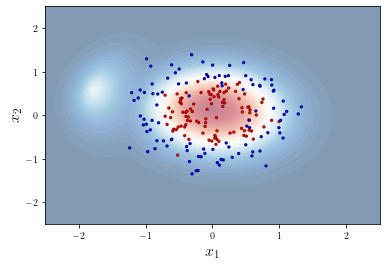

In [4]:
import optax
circle, circle_train, circle_test = get_planar_dataset_with_circular_bias('circle')

test_loss = np.inf

opt = optax.adam(0.01)
update = get_update_fn(opt)

# want the final test loss to be less than 0.4 to get reasonably good classification performance.

while test_loss > 0.4:
    X, y = jnp.array(circle_train.X), jnp.array(circle_train.y)
    X_test, y_test = jnp.array(circle_test.X), jnp.array(circle_test.y)
    n = 1
    params = onn_t.init(None, jnp.array(circle_train.X), jnp.array(circle_train.y))
    opt_state = opt.init(params)
    circle_test_losses = []
    circle_params_list = []
    circle_ridx_list = []
    for step in pbar(range(1000)):
        ridx = np.random.choice(X.shape[0], n, replace=False)
        test_loss = loss(params, X_test, y_test)
        circle_test_losses.append(test_loss)
        params, opt_state = update(params, opt_state, X[ridx], y[ridx])
        circle_params_list.append(params)
        circle_ridx_list.append(ridx)
    print(f"𝓛: {test_loss:.5f}")
    
circle = {
    'X_train': np.array(X),
    'y_train': np.array(y),
    'X_test': np.array(X_test),
    'y_test': np.array(y_test),
    'params_list': circle_params_list,
    'ridx_list': circle_ridx_list
}    

plot_planar_boundary_from_dataset(plt, circle_train, circle_params_list, -1)

### Moons

  0%|          | 0/2000 [00:00<?, ?it/s]

𝓛: 0.17278


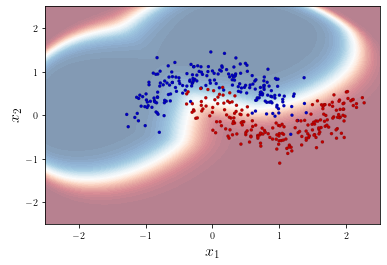

In [5]:
moon, moon_train, moon_test = get_planar_dataset_with_circular_bias('moons')

test_loss = np.inf

opt = optax.adam(0.01)
update = get_update_fn(opt)

while test_loss > 0.18:
    X, y = jnp.array(moon_train.X), jnp.array(moon_train.y)
    X_test, y_test = jnp.array(moon_test.X), jnp.array(moon_test.y)
    n = 2
    params = onn_t.init(None, jnp.array(moon_train.X), jnp.array(moon_train.y))
    opt_state = opt.init(params)
    moon_test_losses = []
    moon_params_list = []
    moon_ridx_list = []
    for step in pbar(range(2000)):
        ridx = np.random.choice(X.shape[0], n, replace=False)
        test_loss = loss(params, X_test, y_test)
        moon_test_losses.append(test_loss)
        params, opt_state = update(params, opt_state, X[ridx], y[ridx])
        moon_params_list.append(params)
        moon_ridx_list.append(ridx)
    test_loss = np.min(moon_test_losses)
    print(f"𝓛: {test_loss:.5f}")

moons = {
    'X_train': np.array(X),
    'y_train': np.array(y),
    'X_test': np.array(X_test),
    'y_test': np.array(y_test),
    'params_list': moon_params_list,
    'ridx_list': moon_ridx_list,
}

plot_planar_boundary_from_dataset(plt, moon_train, moon_params_list, -1)

## Step 2: Initialize the chip and start the GUI interface for debugging

In [3]:
if RUN_EXPERIMENT:
    with open('../calibrations/ps_calibration_1560nm_20221023.p', 'rb') as f:
        ps_calibration = pickle.load(f)
    chip = AMF420Mesh(
        home=(0.0, 0.0),  #mm
        interlayer_xy=(0.0015, -0.3095),  #mm
        spot_rowcol=(447, 23),
        interspot_xy=(-67, 292),
        ps_calibration=ps_calibration,
        stage_port='/dev/ttyUSB4',
        laser_port='/dev/ttyUSB0',
        window_dim=(30, 30),
        integration_time=3000,
        # pd_calibration=np.load('pd_calibration.npy')
    )

XDeviceURLHelper::CreateDeviceURL
XDeviceURL::Validate; url = cam://0


In [4]:
chip.default_panel()

Column
    [0] Row
        [0] Column
            [0] HoloViews(DynamicMap)
            [1] Row
                [0] Button(name='Mesh Image')
                [1] Button(name='Self-Configure (...)
                [2] Button(name='Set 4-point DFT')
                [3] Row
                    [0] Button(name='dft0', width=25)
                    [1] Button(name='dft1', width=25)
                    [2] Button(name='dft2', width=25)
                    [3] Button(name='dft3', width=25)
        [1] Column
            [0] Button(name='Zero Voltages')
            [1] Button(name='Transparent (Bar)')
            [2] Button(name='Transparent (Cross)')
            [3] Button(name='Alternate In (...)
            [4] Button(name='Uniform In (1-1-1-1-1)')
            [5] Row
                [0] Button(name='0', width=15)
                [1] Button(name='1', width=15)
                [2] Button(name='2', width=15)
                [3] Button(name='3', width=15)
                [4] Button(name='4', width=15)
    [1] Row
        [0] Tabs
            [0] Column
                [0] Row
                    [0] Row
                        [0] Column
                            [0] HoloViews(DynamicMap)
                            [1] Row
                                [0] Toggle(name='Livestream')
                                [1] Button(name='Capture')
                        [1] Column
                            [0] IntInput(end=640, name='Initial Spot Row', start=0, value=447)
                            [1] IntInput(end=512, name='Initial Spot Col', start=0, value=23)
                            [2] IntInput(end=50, name='Initial Window Width', start=15, value=30)
                            [3] IntInput(end=50, name='Initial Window Height', start=0, value=30)
                            [4] FloatInput(end=0.01, name='Initial Interlayer X..., start=-0.01, step=0.0001, value=0.0015)
                            [5] FloatInput(end=0.5, name='Initial Interlayer Y..., start=-0.5, step=0.0001, value=-0.3095)
                            [6] IntInput(end=400, name='Initial Interspot X..., start=-400, value=292)
                            [7] IntInput(end=100, name='Initial Interspot Y..., start=-100, value=-67)
                    [1] Column
                        [0] Column
                            [0] FloatSlider(format='1[.]000', name='X Position', start=-1, step=0.001)
                            [1] FloatSlider(end=0.2, format='1[.]000', name='Y Position', start=-6.18, step=0.001)
                            [2] Button(name='Sync Stage Position')
                        [1] Button(name='Home')
                        [2] Column
                            [0] FloatSlider(end=4.25, format='1[.]000', name='Power (mW)', start=0.05, step=0.001, value=0.38699999999999996)
                            [1] Toggle(name='Laser Enable', value=True)
                        [3] FloatSlider(end=1.584, format='1[.]000', name='Wavelength (um)', start=1.53, step=0.001, value=1.56)
                        [4] FloatSlider(end=3, format='1[.]000', name='LED Voltage', step=0.01)
                        [5] Button(name='Switch Propagation D...)
            [1] Column
                [0] Select(name='Phase Shifter', options=['1, 1', '5, 0', ...], value='1, 1')
                [1] Row
                    [0] Button(name='0', width=40)
                    [1] Button(name='π/2', width=40)
                    [2] Button(name='π', width=40)
                    [3] Button(name='3π/2', width=40)
                    [4] Button(name='-θ', width=40)
                    [5] Button(name='+π', width=40)
                    [6] Button(name='-π', width=40)
                    [7] Button(name='+π/2', width=40)
                    [8] Button(name='-π/2', width=40)
                [2] Button(name='To PS Layer')
                [3] ParamFunction(function)
                [4] Row
                    [0] HoloViews(Overlay)
                    [1] HoloViews(Overlay)
        [1] Col

## Calibrate the chip if necessary

In [19]:
import datetime
CALIBRATE = False  # set to True if you need to calibrate the chip

if CALIBRATE:
    chip.calibrate_all(pbar=pbar)
    chip.to_calibration_file(f'../calibrations/ps_calibration_1560nm_{datetime.datetime.now().strftime("%Y%m%d")}.p')

In [6]:
# chip.calibrate_thetas(pbar=pbar)

## Step 3: Train the photonic neural network on moons dataset (slow, or load data)

This task can take several hours or even a full day to run because the stage has to move across the chip to imge spots throughout the mesh.

For each step of the training procedure, we calculate both the predicted gradient and the measured gradient and that data is stored in `backprop.meas` and `backprop.pred` dictionaries.

In the actual demonstration, the photonic neural net training task would take much less time and energy (e.g., using integrated PDs, no stage required, and thermal phase shifts).

To reproduce the results, we have included already measured data and show how that data can be analyzed to generate the figures of the paper.

In [55]:
RUN_EXPERIMENT = False
if RUN_EXPERIMENT:
    X_ = np.array(moons['X_train'])
    y_ = np.array(moons['y_train'])

    X_test, y_test = jnp.array(moons['X_test']), jnp.array(moons['y_test'])

    opt = optax.adam(0.01)
    num_iterations = 2500
    moon_training = []
    params = moons['params_list'][0]
    params_list = [params]
    opt_state = opt.init(params)
    grads = {}
    for iteration in pbar(range(num_iterations)):
        ridx = moons['ridx_list'][iteration]
        buffer.send(np.array([(iteration, loss(params, X_test, y_test))]))
        backprop = BackpropAccuracyTest(chip, [params], X_[ridx], y_[ridx], np.arange(batch_size), 0)
        backprop.run(phase_cheat=False)  # set to True for better performance to assess phase-related error
        moon_training.append({
            'meas': backprop.meas,
            'pred': backprop.pred,
            'idx': ridx,
            'train_loss': loss(params, X_, y_),
            'test_loss': loss(params, X_test, y_test),
        })
        for layer in (1, 2, 3):
            grads[f'layer{layer}'] = {}
            for ps in ('theta', 'phi'):
                grads[f'layer{layer}'][ps] = jnp.array(np.mean(backprop.meas['gradients'][f'layer{layer}'][ps], axis=0))
            grads[f'layer{layer}']['gamma'] = jnp.zeros(4) # we know this gradient is zero.
        updates, opt_state = opt.update(to_haiku_dict(grads), opt_state)
        params_list.append(params)
        params = optax.apply_updates(params, updates)
else:
    with open('moon_experiment_fig3_meas.p', 'rb') as f:
        moons_meas = pickle.load(f)
    with open('moon_experiment_fig3_corr.p', 'rb') as f:
        moons_corr = pickle.load(f)
    with open('circle_experiment_fig3.p', 'rb') as f:
        circle = pickle.load(f)
    with open('moon_minibatch10.p', 'rb') as f:
        moons_minibatch = pickle.load(f)
        
def grad_errors(dataset):
    errors = []
    norms = []
    for iteration in range(1000):
        g, ghat = np.array([]), np.array([])
        for layer in (1, 2, 3):
            meas = dataset['experiment'][iteration]['meas']['gradients'][f'layer{layer}']
            pred = dataset['experiment'][iteration]['pred']['gradients'][0][f'layer{layer}']
            ghat = np.hstack((ghat, np.hstack((meas['theta'][0], meas['phi'][0]))))
            g = np.hstack((g, np.hstack((pred['theta'], pred['phi']))))
        errors.append(1 - (g @ ghat) / (np.linalg.norm(g) * np.linalg.norm(ghat)))
        norms.append(np.linalg.norm(g))
    return errors

# Analyze the model metrics of the various experiments

In [16]:
from phox.apps.onn2d import onn_a

@jax.jit
def accuracy(params, X, y):
    return onn_a.apply(params, X, y)

train_accuracy = np.array([accuracy(circle['params_list'][i],
                           circle['X_train'],
                           circle['y_train']) for i in pbar(range(1000))])
test_accuracy = np.array([accuracy(circle['params_list'][i],
                          circle['X_test'],
                          circle['y_test']) for i in pbar(range(1000))])

test_accuracy_meas = np.array([accuracy(moons_meas['params_list'][i],
                              moons_corr['X_test'],
                              moons_corr['y_test']) for i in range(1000)])
train_accuracy_meas = np.array([accuracy(moons_meas['params_list'][i],
                               moons_meas['X_train'],
                               moons_meas['y_train']) for i in range(1000)])

test_accuracy_corr = np.array([accuracy(moons_corr['params_list'][i],
                               moons_corr['X_test'],
                               moons_corr['y_test']) for i in range(2000)])
train_accuracy_corr = np.array([accuracy(moons_corr['params_list'][i],
                                moons_corr['X_train'],
                                moons_corr['y_train']) for i in range(2000)])


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

## Gradient error

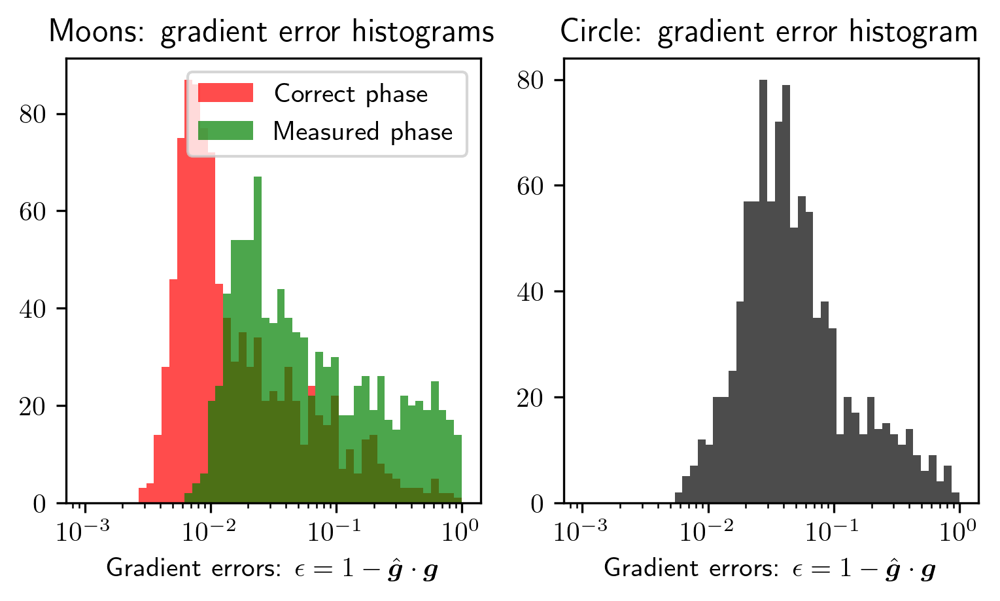

In [20]:
plt.figure(dpi=300, figsize=(6, 3))

plt.subplot(121)

plt.hist(grad_errors(moons_corr), bins=np.logspace(-3, 0), color='red', alpha=0.7)
plt.xlabel('Gradient errors')
plt.xscale('log')

plt.hist(grad_errors(moons_meas), bins=np.logspace(-3, 0), color='green', alpha=0.7)
plt.xlabel(r'Gradient errors: $\epsilon = 1 - \hat{\bm{g}} \cdot \bm{g}$')
plt.xscale('log')

plt.title('Moons: gradient error histograms')
plt.legend(['Correct phase', 'Measured phase'])

plt.subplot(122)
plt.hist(grad_errors(circle), bins=np.logspace(-3, 0), color='black', alpha=0.7)
plt.xlabel(r'Gradient errors: $\epsilon = 1 - \hat{\bm{g}} \cdot \bm{g}$')
plt.xscale('log')

plt.title('Circle: gradient error histogram')
plt.savefig('gradient_errors.pdf')

In [28]:
def replay(dataset, n_iters=None):
    test_loss = np.inf
    n_iters = len(dataset['ridx_list']) if n_iters is None else n_iters

    opt = optax.adam(0.01)
    update = get_update_fn(opt)

    X, y = jnp.array(dataset['X_train']), jnp.array(dataset['y_train'])
    X_test, y_test = jnp.array(dataset['X_test']), jnp.array(dataset['y_test'])
    n = 1
    params = dataset['params_list'][0]
    opt_state = opt.init(params)
    test_losses = []
    train_losses = []
    params_list = []
    for step in pbar(range(n_iters)):
        ridx = dataset['ridx_list'][step]
        train_loss = loss(params, X, y)
        test_loss = loss(params, X_test, y_test)
        test_losses.append(test_loss)
        train_losses.append(train_loss)
        params, opt_state = update(params, opt_state, X[ridx], y[ridx])
        params_list.append(params)
    print(f"𝓛: {test_loss:.5f}")
    return train_losses, test_losses

moons_train_losses, moons_test_losses = replay(moons_corr)
circle_train_losses, circle_test_losses = replay(circle)

  0%|          | 0/3000 [00:00<?, ?it/s]

𝓛: 0.18883


  0%|          | 0/1000 [00:00<?, ?it/s]

𝓛: 0.32184


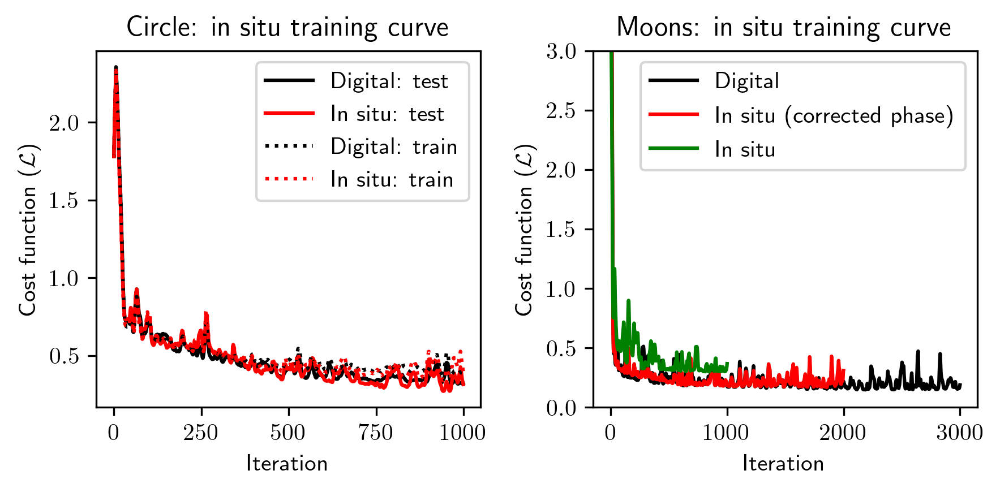

In [30]:
plt.figure(dpi=300, figsize=(6, 3))

plt.subplot(121)
plt.plot(circle_test_losses, color='black')
plt.plot([c['test_loss'] for c in circle['experiment']], color='red')
plt.plot(circle_train_losses, linestyle='dotted', color='black')
plt.plot([c['train_loss'] for c in circle['experiment']], linestyle='dotted', color='red')
plt.xlabel('Iteration')
plt.ylabel('Cost function ($\mathcal{L}$)')

plt.legend(['Digital: test', 'In situ: test',
            'Digital: train', 'In situ: train'])
plt.title('Circle: in situ training curve')

plt.subplot(122)

plt.plot(moons_test_losses, color='black')
plt.plot([c['test_loss'] for c in moons_corr['experiment']][:2000], color='red')
plt.plot([c['test_loss'] for c in moons_meas['experiment']][:2000], color='green')
plt.xlabel('Iteration')
plt.ylabel('Cost function ($\mathcal{L}$)')
plt.ylim((0, 3))

plt.legend(['Digital', 'In situ (corrected phase)', 'In situ'])
plt.title('Moons: in situ training curve')
plt.tight_layout()

## More in-depth comparison of the circle and moons experiments

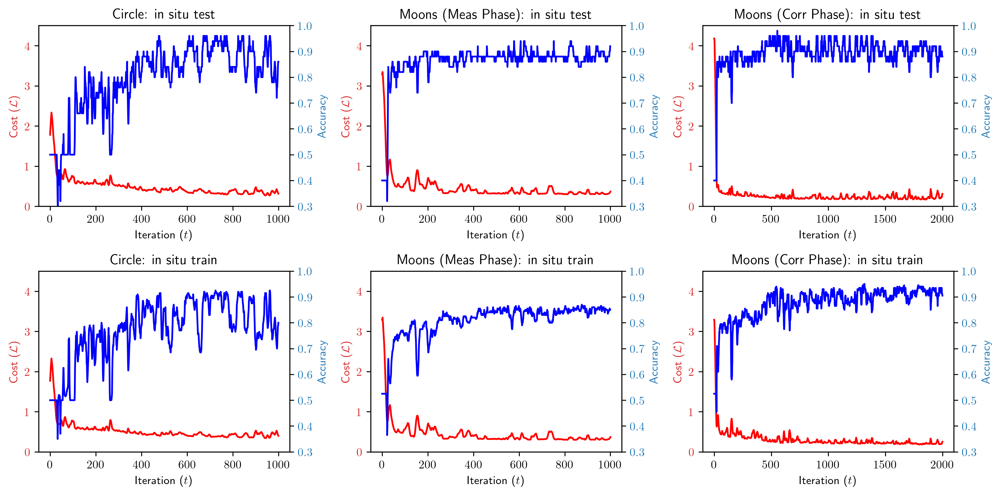

In [104]:
import numpy as np
import matplotlib.pyplot as plt

plt.figure(dpi=300, figsize=(12, 6))

def cost_accuracy_plot(dataset, accuracy, title, ax=None, test=True, n_iters=10000):
    ax1 = plt.gca() if ax is None else ax

    color = 'tab:red'
    ax1.set_xlabel('Iteration ($t$)')
    ax1.set_ylabel('Cost ($\mathcal{L}$)', color=color)
    ax1.plot([c[f'{"test" if test else "train"}_loss'] for c in dataset['experiment'][:n_iters]], color='red')
    ax1.tick_params(axis='y', labelcolor=color)
    ax1.set_ylim((0, 4.5))

    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

    color = 'tab:blue'
    ax2.set_ylabel('Accuracy', color=color)  # we already handled the x-label with ax1
    ax2.plot(accuracy[:n_iters], color='blue')
    ax2.tick_params(axis='y', labelcolor=color)
    ax2.set_ylim((0.3, 1))
    plt.title(f'{title}: in situ {"test" if test else "train"}')

plt.subplot(231)
cost_accuracy_plot(circle, test_accuracy, 'Circle')
plt.subplot(234)
cost_accuracy_plot(circle, train_accuracy, 'Circle', test=False)
plt.subplot(232)
cost_accuracy_plot(moons_meas, test_accuracy_meas, 'Moons (Meas Phase)')
plt.subplot(235)
cost_accuracy_plot(moons_meas, train_accuracy_meas, 'Moons (Meas Phase)', test=False,)
plt.subplot(233)
cost_accuracy_plot(moons_corr, test_accuracy_corr, 'Moons (Corr Phase)', n_iters=2000)
plt.subplot(236)
cost_accuracy_plot(moons_corr, train_accuracy_corr, 'Moons (Corr Phase)', test=False, n_iters=2000)

plt.tight_layout()  # otherwise the right y-label is slightly clipped
plt.savefig('backprop_accuracy_and_cost.pdf', bbox_inches=None)

## Full breakdown of the digital subtraction update

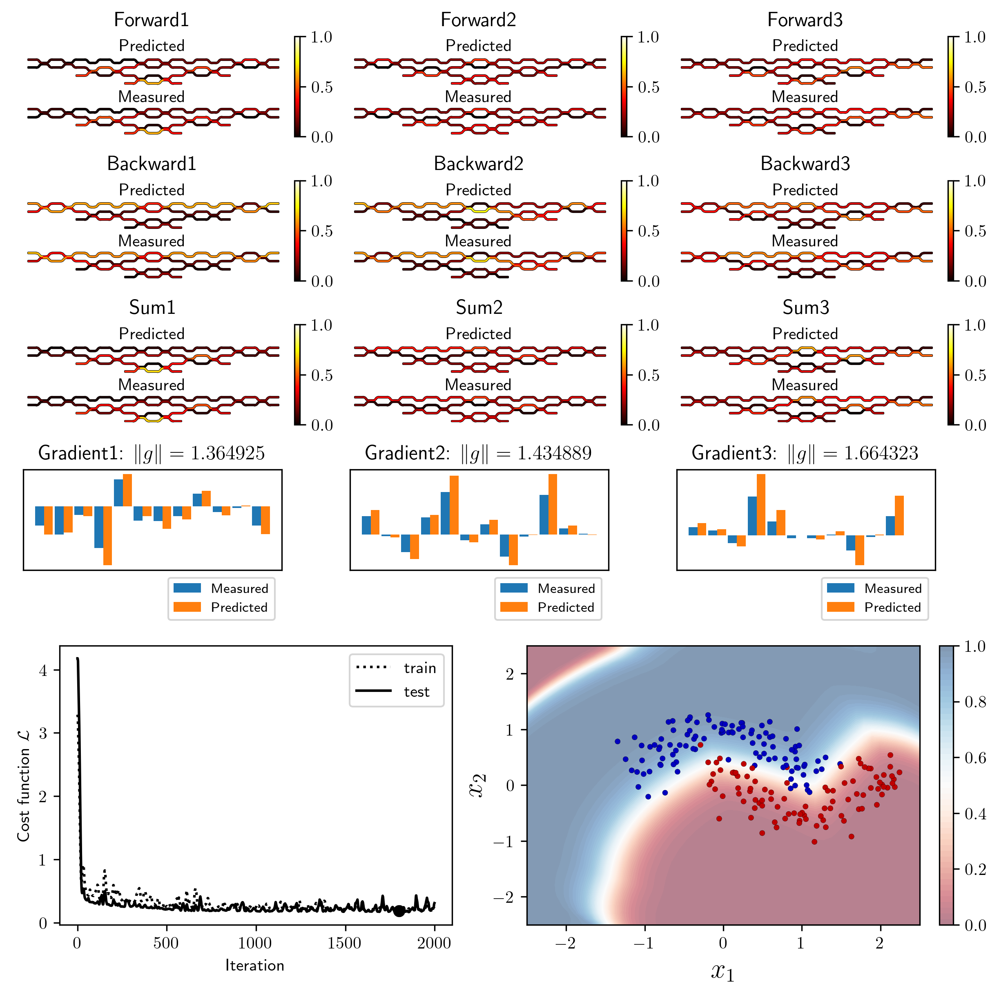

In [52]:
fig = plt.figure(dpi=300, figsize=(8, 8), constrained_layout=True)
plot_amf420_backprop_iteration(fig, moons_corr, iteration=1800, final_iteration=2000)
plt.savefig('training_backprop_fig_moons_corr.pdf')

## Appendix material

### The minibatch problem

Analyze the scaling of minibatch size versus error.

In [61]:
errors = {}
batch_size = np.arange(1, 11)
for bs in pbar(batch_size):
    errors[bs] = []
    for i in range(len(moons_minibatch['experiment'])):
        pred = np.array([])
        meas = np.array([])
        for layer in (1, 2, 3):
            pred_phi = np.mean(moons_minibatch['experiment'][i]['meas']['gradients'][f'layer{layer}']['phi'][:bs], axis=0)
            meas_phi = np.mean([moons_minibatch['experiment'][i]['pred']['gradients'][idx][f'layer{layer}']['phi'] for idx in range(bs)], axis=0)
            pred_phi = pred_phi
            meas_phi = meas_phi
            pred_theta = np.mean(moons_minibatch['experiment'][i]['meas']['gradients'][f'layer{layer}']['theta'][:bs], axis=0)
            meas_theta = np.mean([moons_minibatch['experiment'][i]['pred']['gradients'][idx][f'layer{layer}']['theta'] for idx in range(bs)], axis=0)
            pred_theta = pred_theta
            meas_theta = meas_theta
            pred = np.hstack((pred, pred_phi, pred_theta))
            meas = np.hstack((meas, meas_phi, meas_theta))
        errors[bs].append(pred @ meas / (np.linalg.norm(pred) * np.linalg.norm(meas)))

  0%|          | 0/10 [00:00<?, ?it/s]

In [76]:
np.mean(moons_minibatch['experiment'][1]['meas']['gradients'][f'layer{layer}']['phi'][:bs], axis=0)

array([ 0.00174896,  0.32006856,  0.01129076, -0.36215322, -0.01153411,
       -0.27340586])

In [77]:
np.mean(np.array([moons_minibatch['experiment'][1]['pred']['gradients'][idx][f'layer{layer}']['phi'] for idx in range(bs)]), axis=0)

array([-6.4428586e-01,  1.8994999e-01, -1.8294278e-01, -1.2007174e+00,
       -9.4075873e-02,  1.5497207e-07], dtype=float32)

### Get all of the ring and moons device metrics data

In [2]:
RUN_EXPERIMENT = False
if RUN_EXPERIMENT:
    num_iterations = 300

    ring, ring_train, ring_test = get_planar_dataset_with_circular_bias('moons')

    ring_model = Sequential([
        TM(4, activation=Activation(cnorm)),
        TM(4, activation=Activation(cnorm)),
        TM(4, activation=Activation(cnorm)),
        Activation(cnormsq),
        Lambda(lambda x: tf.transpose(tf.math.real(
            tf.convert_to_tensor((tf.reduce_sum(x[:, :2], axis=1), tf.reduce_sum(x[:, 2:], axis=1)))))
              ),
        Activation('softmax')
    ])

    ring_test_losses = []
    ring_model.compile(loss='categorical_crossentropy',
                       optimizer=tf.keras.optimizers.Adam(lr=0.08))
    iterator = pbar(range(num_iterations))
    for iteration in iterator:
        test_loss = ring_model.evaluate(ring_test.X, ring_test.y, verbose=0)
        ring_model.train_on_batch(ring_train.X, ring_train.y)
        ring_test_losses.append(test_loss)
        iterator.set_description(f"𝓛: {test_loss:.5f}")

    chip.set_transparent()
    onn = ONN2D(ring_train, ring_test, 3)
    onn.set_model(ring_model)
    onn.classify_train(chip, ring_model, pbar=pbar)
    onn.classify_test(chip, ring_model, pbar=pbar)
    with open('ring_onn_device.p', 'wb') as f:
        dill.dump({
            'onn': onn,
            'model': ring_model
        }, f)

    moons, moons_train, moons_test = get_planar_dataset_with_circular_bias('moons')

    moons_model = Sequential([
        TM(4, activation=Activation(cnorm)),
        TM(4, activation=Activation(cnorm)),
        TM(4, activation=Activation(cnorm)),
        Activation(cnormsq),
        Lambda(lambda x: tf.transpose(tf.math.real(tf.convert_to_tensor(
            (tf.reduce_sum(x[:, :2], axis=1), tf.reduce_sum(x[:, 2:], axis=1)))))),
        Activation('softmax')
    ])    

    chip.set_transparent()
    onn = ONN2D(moons_train, moons_test, 3)
    onn.set_model(moons_model)
    onn.classify_train(chip, moons_model, pbar=pbar)
    onn.classify_test(chip, moons_model, pbar=pbar)
    with open('moons_onn_device.p', 'wb') as f:
        dill.dump({
            'onn': onn,
            'model': moons_model
        }, f)

with open('ring_onn_device.p', 'rb') as f:
    ring_onn = pickle.load(f)
with open('moons_onn_device.p', 'rb') as f:
    moons_onn = pickle.load(f)

In [54]:
with open('ring_onn_device.p', 'rb') as f:
    ring_onn = pickle.load(f)
with open('moons_onn_device.p', 'rb') as f:
    moons_onn = pickle.load(f)

### Plot everything

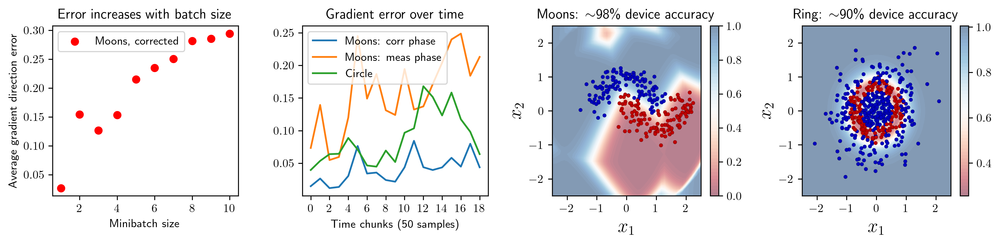

In [13]:
plt.figure(dpi=300, figsize=(12, 3))
plt.subplot(141)
plt.title('Error increases with batch size')
plt.scatter(np.arange(1, 11), [1 - np.mean(errors[i]) / 6 for i in range(1, 11)], color='red')
plt.xlabel('Minibatch size')
plt.ylabel('Average gradient direction error')
plt.legend(['Moons, corrected'])

n = 50
plt.subplot(142)
plt.plot([np.mean(grad_errors(moons_corr)[i * 50: (i + 1) * 50]) for i in range(1, 1000 // n)])
plt.plot([np.mean(grad_errors(moons_meas)[i * 50: (i + 1) * 50]) for i in range(1, 2000 // n)])
plt.plot([np.mean(grad_errors(circle)[i * 50: (i + 1) * 50]) for i in range(1, 1000 // n)])
plt.xlabel(r'Time chunks (50 samples)')
plt.title('Gradient error over time')
plt.legend(['Moons: corr phase', 'Moons: meas phase', 'Circle'])
plt.gca().set_xticks(np.arange(10) * 2)

plt.subplot(143)
moons_onn['onn'].plot(plt, moons_onn['model'], ax=plt.gca())
plt.title('Moons: $\sim$98\% device accuracy')
plt.xticks([-2, -1, 0, 1, 2])

plt.subplot(144)
ring_onn['onn'].plot(plt, ring_onn['model'], ax=plt.gca())
plt.xticks([-2, -1, 0, 1, 2])
plt.title('Ring: $\sim$90\% device accuracy')
plt.tight_layout()

plt.savefig('backprop_minibatch_gradient_time.pdf')

## Analog backpropagation demonstration

In [169]:
from scipy.stats import unitary_group
from simphox.circuit import triangular
from jax import grad
import copy
from scipy.linalg import dft
import pickle

def flatten_grad(grad):
    return np.hstack((grad['theta'].flatten(), grad['phi'].flatten()))

def compare_grads_normed(grad1, grad2):
    grad1_flat = flatten_grad(grad1)
    grad2_flat = flatten_grad(grad2)
    return 1 - grad1_flat @ grad2_flat / (np.linalg.norm(grad1_flat) * np.linalg.norm(grad2_flat))

def batch_grad(grad):
    return np.hstack((grad['theta'].sum(axis=0), grad['phi'].sum(axis=0)))

def compare_batch_grads_normed(grad1, grad2):
    grad1_flat = batch_grad(grad1)
    grad2_flat = batch_grad(grad2)
    return 1 - grad1_flat @ grad2_flat / (np.linalg.norm(grad1_flat) * np.linalg.norm(grad2_flat))

def normalized_error(u: np.ndarray, use_jax: bool = False):
    xp = jnp if use_jax else np
    u = jnp.array(u) if use_jax else u
    return lambda uhat: xp.sqrt(
        1 - xp.trace(xp.abs(u.conj().T @ uhat) ** 2) / xp.trace(xp.abs(uhat.conj().T @ uhat) ** 2))

GENERATE_DATA = False

if GENERATE_DATA:
    sigmas = np.array([1, 0.5, 0.2, 0.1] * 20)
    u = dft(4) / 2
    analog_update_results = {sigma: [] for sigma in sigmas}
    for sigma in pbar(sigmas):
        analog_update_results[sigma].append(gradient_analog_update_test(chip, sigma, u, include_sweep=False))
    with open('analog_subtraction_update_results.p', 'wb') as f:
        pickle.dump(analog_update_results, f)
else:
    with open('analog_subtraction_update_results.p', 'rb') as f:
        analog_update_results = pickle.load(f)

In [170]:
errors_analog = {}
errors_digital = {}
errors_analog_batch = {}
errors_digital_batch = {}
errors_analog_by_convergence_distance = []
errors_digital_by_convergence_distance = []
errors_analog_batch_by_convergence_distance = []
errors_digital_batch_by_convergence_distance = []
convergence_distance = []

for sigma in analog_update_results:
    errors_analog[sigma] = [compare_grads_normed(analog_update_results[sigma][i]['pred']['gradients'],
                                                 analog_update_results[sigma][i]['meas']['gradients_analog']) for i in range(20)]

    errors_digital[sigma] = [compare_grads_normed(analog_update_results[sigma][i]['pred']['gradients'],
                                                  analog_update_results[sigma][i]['meas']['gradients']) for i in range(20)]
    
    errors_analog_batch[sigma] = [compare_batch_grads_normed(analog_update_results[sigma][i]['pred']['gradients'],
                                                             analog_update_results[sigma][i]['meas']['gradients_analog']) for i in range(20)]

    errors_digital_batch[sigma] = [compare_batch_grads_normed(analog_update_results[sigma][i]['pred']['gradients'],
                                                              analog_update_results[sigma][i]['meas']['gradients']) for i in range(20)]
    
    errors_analog_by_convergence_distance += errors_analog[sigma]
    errors_digital_by_convergence_distance += errors_digital[sigma]
    errors_analog_batch_by_convergence_distance += errors_analog_batch[sigma]
    errors_digital_batch_by_convergence_distance += errors_digital_batch[sigma]
    convergence_distance += [normalized_error(analog_update_results[sigma][i]['u'])(analog_update_results[sigma][i]['uhat']) for i in range(20)]

/tmp/ipykernel_1795014/491285204.py:63: UserWarning: Attempted to set non-positive left xlim on a log-scaled axis.
Invalid limit will be ignored.
  plt.xlim((0, 1.1))


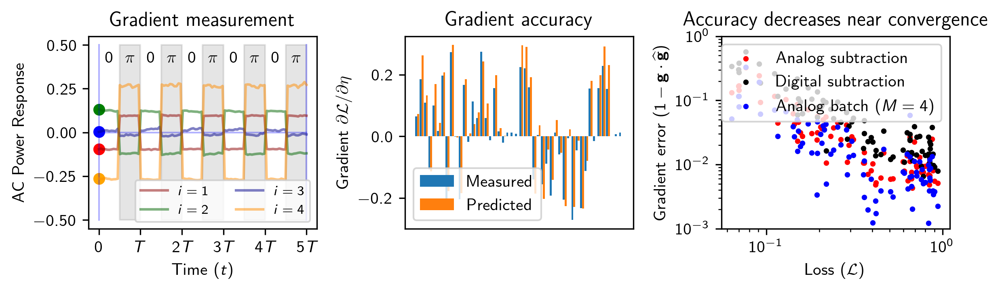

In [176]:
import matplotlib.pyplot as plt
import matplotlib
plt.rcParams.update({"text.usetex": True})
plt.rcParams['text.latex.preamble'] = r"\usepackage{bm} \usepackage{amsmath} \usepackage[cm]{sfmath}"
plt.rc('font', family='sans-serif')

bar_width = 0.45
plt.figure(dpi=300, figsize=(8, 2.5))
plt.subplot(131)
h = 0.5
for x in (0, 2):
    plt.plot((x * np.pi, x * np.pi), (-h, h), color='blue', alpha=0.3, linewidth=1)
plt.plot((0, 2 * np.pi), (0, 0), color='blue', alpha=0.3, linewidth=1)

z = 11

data = analog_update_results[1][z]['meas']['toggle'][2, ::4, 2]
plt.scatter(0, data[0] - np.mean(data), color='red')
plt.plot(np.linspace(0, 2 * np.pi, data.size), data - np.mean(data), color='darkred', label='$i = 1$', alpha=0.5)
data = analog_update_results[1][z]['meas']['toggle'][2, 1::4, 2]
plt.scatter(0, data[0] - np.mean(data), color='green')
plt.plot(np.linspace(0, 2 * np.pi, data.size), data - np.mean(data), color='darkgreen', label='$i = 2$', alpha=0.5)
data = analog_update_results[1][z]['meas']['toggle'][2, 2::4, 2]
plt.scatter(0, data[0] - np.mean(data), color='blue')
plt.plot(np.linspace(0, 2 * np.pi, data.size), data - np.mean(data), color='darkblue', label='$i = 3$', alpha=0.5)
data = analog_update_results[1][z]['meas']['toggle'][2, 3::4, 2]
plt.scatter(0, data[0] - np.mean(data), color='orange')
plt.plot(np.linspace(0, 2 * np.pi, data.size), data - np.mean(data), color='darkorange', label='$i = 4$', alpha=0.5)
plt.legend(ncol=2, fontsize=8, loc=4)
plt.fill_between((np.pi / 5, 2 * np.pi / 5), -h, h, color=(0, 0, 0, 0.1))
plt.fill_between((3 * np.pi / 5, 4 * np.pi / 5), -h, h, color=(0, 0, 0, 0.1))
plt.fill_between((5 * np.pi / 5, 6 * np.pi / 5), -h, h, color=(0, 0, 0, 0.1))
plt.fill_between((7 * np.pi / 5, 8 * np.pi / 5), -h, h, color=(0, 0, 0, 0.1))
plt.fill_between((9 * np.pi / 5, 10 * np.pi / 5), -h, h, color=(0, 0, 0, 0.1))
for i in range(5):
    plt.text((0.5 + 2 * i) * np.pi / 5, 0.4, '$0$', horizontalalignment='center')
    plt.text((1.5 + 2 * i) * np.pi / 5, 0.4, '$\pi$', horizontalalignment='center')


plt.gca().set_xticks(np.arange(6) * 2 * np.pi / 5)
plt.gca().set_xticklabels(['$0$', '$T$', '$2T$', '$3T$', '$4T$', '$5T$'])
plt.ylabel(r'AC Power Response')
plt.xlabel('Time ($t$)')
plt.title(r'Gradient measurement')
plt.subplot(132)
flattened_meas = flatten_grad(analog_update_results[1][10]['meas']['gradients_analog'])
flattened_pred = flatten_grad(analog_update_results[1][10]['pred']['gradients'])
index = np.arange(len(flattened_meas))
summer = plt.gca().bar(index, flattened_meas, bar_width, label="Measured")
winter = plt.gca().bar(index+bar_width, flattened_pred, bar_width, label="Predicted")
plt.legend()
plt.xticks([])
plt.title(r'Gradient accuracy')
plt.ylabel(r'Gradient $\partial{\mathcal{L}} / \partial{\eta}$')
plt.subplot(133)
plt.scatter(convergence_distance, errors_analog_by_convergence_distance, s=5, color='red')
plt.scatter(convergence_distance, errors_digital_by_convergence_distance, s=5, color='black')
plt.scatter(convergence_distance, errors_analog_batch_by_convergence_distance, s=5, color='blue')
plt.yscale('log')
plt.xscale('log')
plt.ylim(0.001, 1)
plt.legend(['Analog subtraction', 'Digital subtraction', 'Analog batch ($M = 4$)'])
plt.xlim((0, 1.1))
plt.title(r'Accuracy decreases near convergence')
plt.xlabel(r'Loss ($\mathcal{L}$)')
plt.ylabel(r'Gradient error ($1 - \mathbf{g} \cdot \widehat{\mathbf{g}}$)')

plt.tight_layout()

plt.savefig('backprop_analog_gradient.pdf', bbox_inches=None)

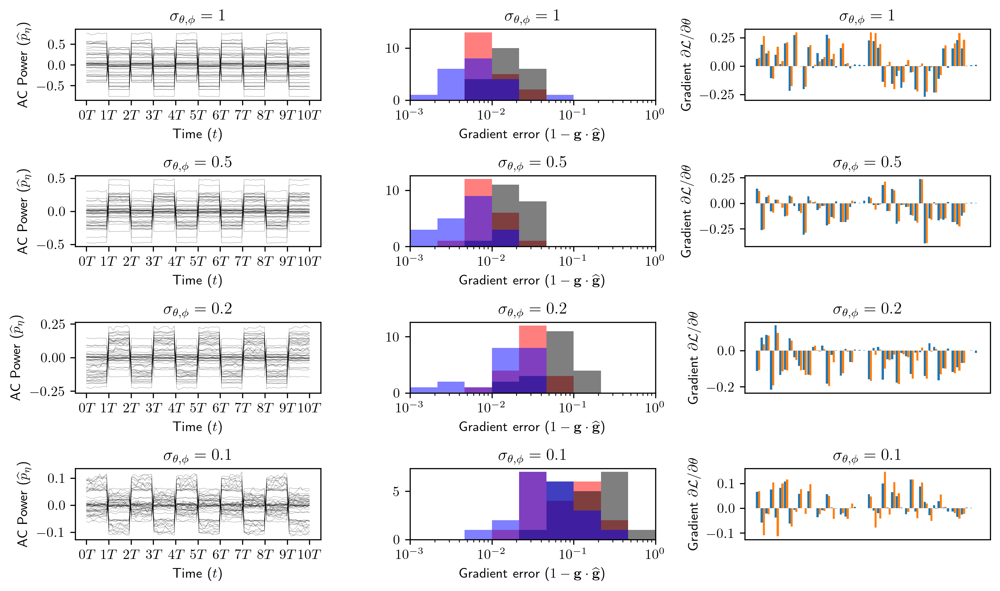

In [104]:
PHI_LOCS = [(0, 0), (2, 1), (4, 2), (4, 0), (6, 1), (8, 0)]
THETA_LOCS = [(1, 0), (3, 1), (5, 2), (5, 0), (7, 1), (9, 0)]

plt.figure(dpi=300, figsize=(10, 6))

z = 10
r = 1
s = 5
for m, sigma in enumerate((0.1, 0.2, 0.5, 1)[::-1]):
    plt.subplot(4, 3, 1 + 3 * m)
    for i, j in PHI_LOCS + THETA_LOCS:
        for k in range(4):
            data = analog_update_results[sigma][z]['meas']['toggle_interleave'][i, k, :, j]
            plt.plot(np.linspace(0, (s * 2) * np.pi, data.size * r), np.tile(data - np.mean(data), r), color='black', alpha=0.5, linewidth=0.2)
    # plt.ylim(-0.1, 0.1)
    # for x in (0, 2, 4, 6):
    #     plt.plot((x * np.pi, x * np.pi), (-0.25, 0.25), color='green', alpha=0.3, linewidth=2)
    plt.gca().set_xticks(np.arange(2 * s + 1) * np.pi)
    plt.gca().set_xticklabels([f'${i}T$' for i in np.arange(2 * s + 1)])
    plt.ylabel(r'AC Power ($\widehat{p}_\eta$)')
    plt.xlabel('Time ($t$)')
    plt.title(r'$\sigma_{\theta, \phi} = '+f'{sigma}$')

for m, sigma in enumerate((0.1, 0.2, 0.5, 1)[::-1]):
    plt.subplot(4, 3, 2 + 3 * m)
    plt.hist(errors_analog[sigma], alpha=0.5, color='red', bins=np.logspace(-3, stop=0, num=10))
    plt.hist(errors_digital[sigma], alpha=0.5, color='black', bins=np.logspace(-3, stop=0, num=10))
    plt.hist(errors_analog_batch[sigma], alpha=0.5, color='blue', bins=np.logspace(-3, stop=0, num=10))
    plt.xscale('log')
    plt.xlim((0.001, 1))
    plt.xlabel('Gradient error ($1 - \mathbf{g} \cdot \widehat{\mathbf{g}}$)')
    plt.title(r'$\sigma_{\theta, \phi} = '+f'{sigma}$')
    
bar_width = 0.45
for i, sigma in enumerate((0.1, 0.2, 0.5, 1)[::-1]):
    plt.subplot(4, 3, 3 + 3 * i)
    flattened_meas = flatten_grad(analog_update_results[sigma][z]['meas']['gradients_analog'])
    flattened_pred = flatten_grad(analog_update_results[sigma][z]['pred']['gradients'])
    index = np.arange(len(flattened_meas))
    summer = plt.gca().bar(index, flattened_meas, bar_width, label="Measured")
    winter = plt.gca().bar(index+bar_width, flattened_pred, bar_width, label="Predicted")
    # plt.legend()
    plt.xticks([])
    plt.title(r'$\sigma_{\theta, \phi} ='+f'{sigma}$')
    plt.ylabel(r'Gradient $\partial{\mathcal{L}} / \partial{\theta}$')
plt.tight_layout()
plt.savefig('analog_expected_vs_actual_gradient.pdf', bbox_inches=None)

In [49]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
plt.rcParams.update({"text.usetex": True})
plt.rcParams['text.latex.preamble'] = r"\usepackage{bm} \usepackage{amsmath}"

In [62]:
with open('batch_grad.p', 'rb') as f:
    grads = pickle.load(f)

# scale the raw measurements!
for i, k in enumerate(grads):
    scale = np.linalg.norm(grads[k].loc['expected']) / np.linalg.norm(grads[k].loc['measured'])
    grads[k].loc['measured'] *= scale

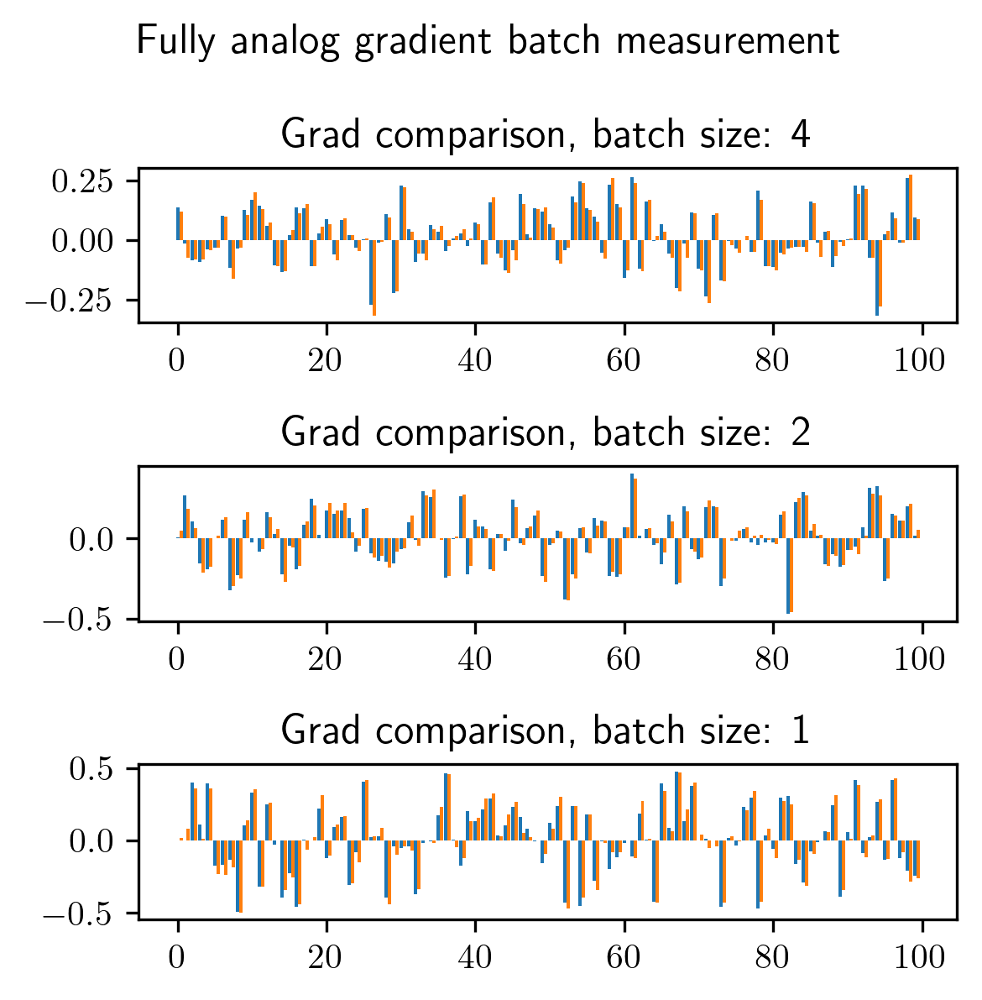

In [46]:
bar_width = 0.45

plt.figure(dpi=300, figsize=(4, 4))

for i, k in enumerate(grads):
    plt.subplot(311 + i)
    index = np.arange(100)
    plt.gca().bar(index, grads[k].loc['measured'][:100], bar_width, label="Measured")
    plt.gca().bar(index+bar_width, grads[k].loc['expected'][:100], bar_width, label="Predicted")
    plt.title(f'Grad comparison, batch size: {k}')
plt.suptitle('Fully analog gradient batch measurement')
plt.tight_layout()

plt.savefig('analog_batch_grad_comparison_direct.pdf')

Text(0.5, 1.0, 'Fully analog gradient measurement')

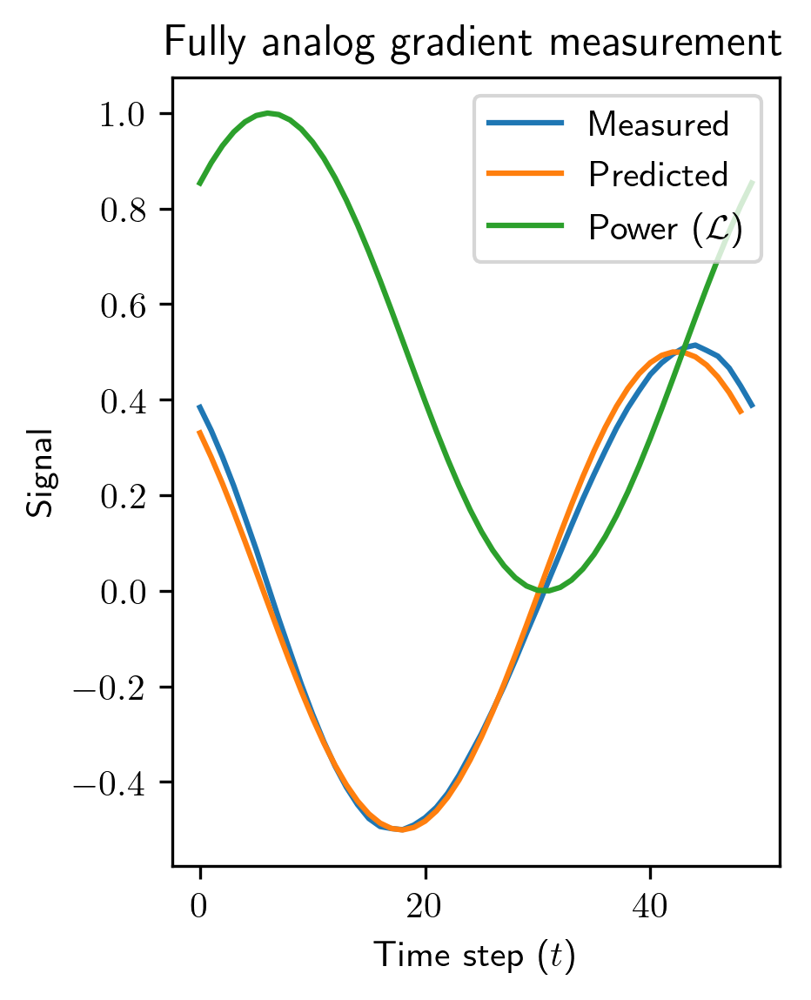

In [51]:
plt.figure(dpi=300, figsize=(3, 4))
powers, meas = xr.open_dataarray('sweep_grad.nc')

pred = np.diff(powers)
# scale up digitally computed gradient to actual gradient
pred *= 0.5 / np.max(pred)
meas = -meas * np.max(pred) / np.max(meas)
plt.plot(meas, label = 'Measured')
plt.plot(pred, label = 'Predicted')
plt.plot(powers, label = 'Power ($\mathcal{L}$)')
plt.legend()
plt.xlabel('Time step ($t$)')
plt.ylabel('Signal')
plt.title('Fully analog gradient measurement')

plt.savefig('analog_single_grad_comparison_direct.pdf')

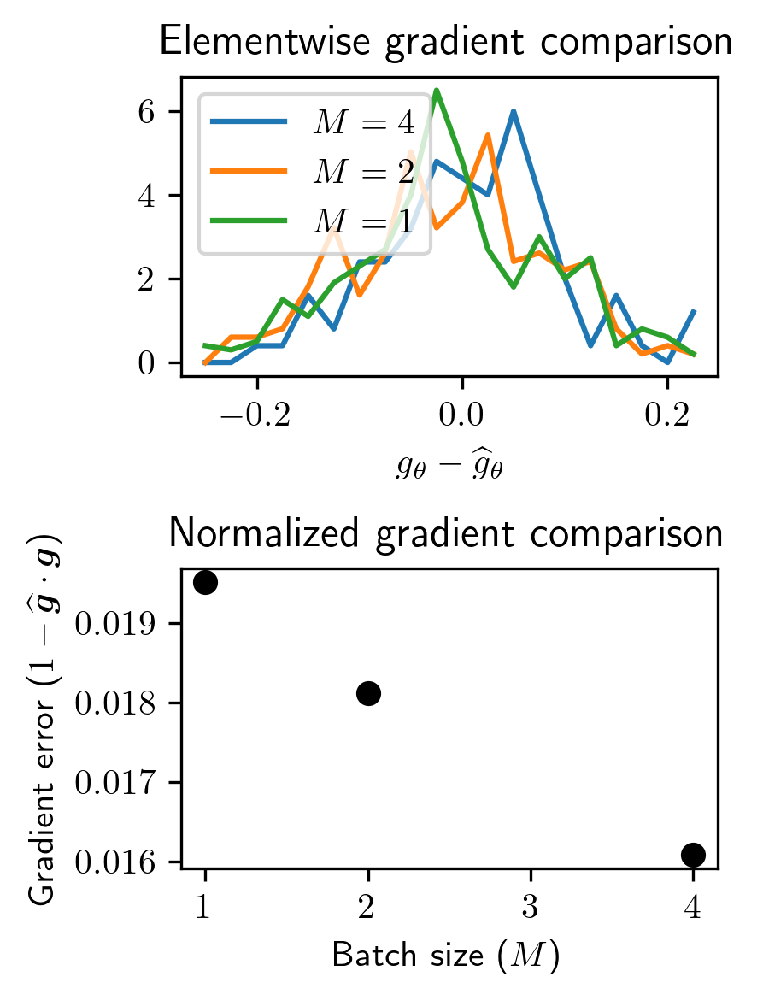

In [89]:
plt.figure(dpi=300, figsize=(3, 4))

plt.subplot(211)
for k in grads:
    vals, bins = np.histogram((grads[k].loc['measured'] - grads[k].loc['expected']) / (0.5 / np.sqrt(k)), density=True, bins=np.linspace(-0.25, 0.25, 21))
    plt.plot(bins[:-1], vals, label = f'$M = {k}$')
plt.legend()
plt.xlabel(r'$g_\theta - \widehat{g}_\theta$')
plt.title('Elementwise gradient comparison')
plt.subplot(212)
plt.scatter([4, 2, 1],
    [1 - (grads[k].loc['measured'] @ grads[k].loc['expected']) / (np.linalg.norm(grads[k].loc['expected']) * np.linalg.norm(grads[k].loc['measured']))
     for k in [4, 2, 1]], color='black')
plt.ylabel(r'Gradient error ($1 - \widehat{\boldsymbol{g}} \cdot \boldsymbol{g}$)')
plt.xlabel(r'Batch size ($M$)')
plt.title('Normalized gradient comparison')
plt.tight_layout()

plt.savefig('analog_batch_grad_comparison_overall.pdf')
